<a href="https://colab.research.google.com/github/wangjalen7/Crime-Hotspot-Visualization-and-Strategy-Model/blob/main/ML4VA_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PRE-PROCESSING THE DATA

In [ ]:
pip install tqdm

In [ ]:
import pandas as pd
import os

def loadCrimeData():
    crime_data = pd.read_csv('ML_Crime_Data.csv')
    return crime_data

crime_data = loadCrimeData()

# check size (in terms of MB)
file_info = os.stat('ML_Crime_Data.csv')
size_in_MB = file_info.st_size / (1024 * 1024)
print(f"Size of the dataset: {size_in_MB:.2f} MB")

# check the number of entries and features
num_entries, num_features = crime_data.shape
print(f"Number of entries: {num_entries}")
print(f"Number of features: {num_features}")

# check for categorical data
categorical_features = crime_data.select_dtypes(include=['object']).columns
print(f"Number of categorical features: {len(categorical_features)}")

# check for missing values
missing_values = crime_data.isnull().sum()
num_missing = missing_values[missing_values > 0].shape[0]
print(f"Number of features with missing values: {num_missing}")

# basic statistics
print("\nBasic statistics for the dataset:")
print(crime_data.describe())

Size of the dataset: 3.97 MB
Number of entries: 24632
Number of features: 13
Number of categorical features: 6
Number of features with missing values: 3

Basic statistics for the dataset:
           RecordID    IncidentID   BlockNumber  HourReported  Unnamed: 9  \
count  24632.000000  2.463200e+04  23060.000000  24632.000000         0.0   
mean   12316.500000  2.020986e+11    880.858630   1348.148019         NaN   
std     7110.790251  1.558016e+08    625.591216    589.366635         NaN   
min        1.000000  2.018000e+11    100.000000      0.000000         NaN   
25%     6158.750000  2.020000e+11    400.000000    959.000000         NaN   
50%    12316.500000  2.021000e+11    800.000000   1406.000000         NaN   
75%    18474.250000  2.022000e+11   1300.000000   1809.000000         NaN   
max    24632.000000  2.023800e+11   7100.000000   2359.000000         NaN   

           Latitude     Longitude  
count  24632.000000  24632.000000  
mean      38.033397    -78.487899  
std       

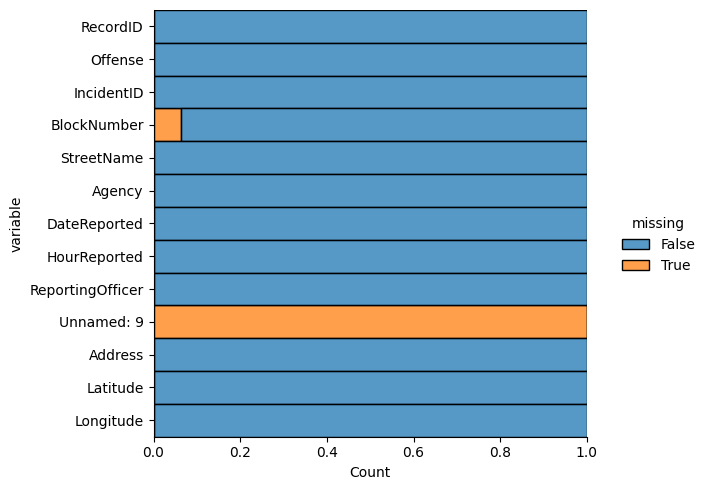

In [ ]:
import seaborn as sns

sns.displot(
    data=crime_data.isna().melt(value_name='missing'),
    y='variable',
    hue='missing',
    multiple='fill',
    aspect=1.25
)

Investigating the null values further, it looks like it's Block Number that's missing. That's fine because we will train using the latitude and longitude values.

#Data Visualization

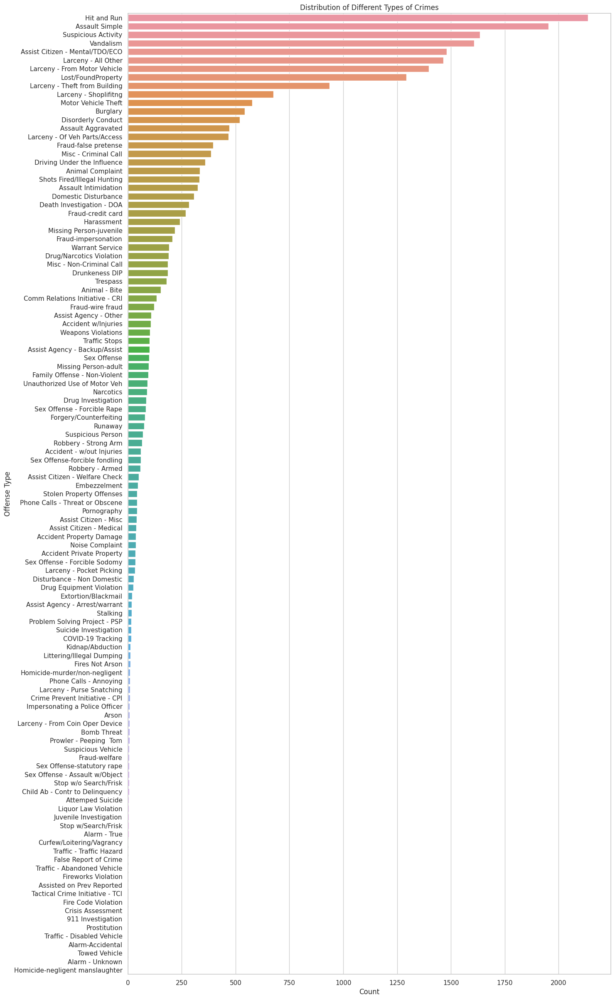

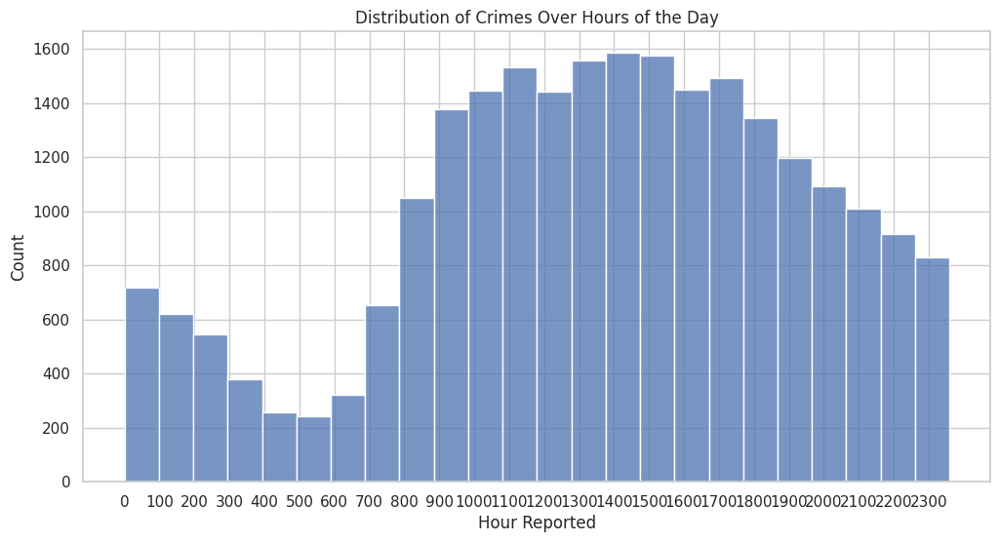

In [ ]:
import matplotlib.pyplot as plt

sns.set(style="whitegrid")

# 1. Distribution of different types of crimes
plt.figure(figsize=(15, 30))
sns.countplot(y='Offense', data=crime_data, order=crime_data['Offense'].value_counts().index)
plt.title('Distribution of Different Types of Crimes')
plt.xlabel('Count')
plt.ylabel('Offense Type')
plt.show()

# 2. Distribution of crimes over hours of the day
plt.figure(figsize=(12, 6))
sns.histplot(crime_data['HourReported'], bins=24, kde=False)
plt.title('Distribution of Crimes Over Hours of the Day')
plt.xlabel('Hour Reported')
plt.ylabel('Count')
plt.xticks(range(0, 2400, 100))
plt.grid(True)
plt.show()

We visualize the data to observe the most frequent crimes as well as the most frequent hours of the day they're committed.

#Feature Engineering

In [ ]:
#if a crime contains the following keywords we may consider it as a more dangerous crime category: crime against person (violent crime) or crime against property
crime_data['PersonalCrime'] = crime_data['Offense'].str.contains('|'.join(['Assault', 'Domestic', 'Sex Offense', 'Stalking', 'Kidnap', 'Homicide', 'Child Ab'])).astype('category')
crime_data['PropertyCrime'] = crime_data['Offense'].str.contains('|'.join(['Hit and Run', 'Vandalism', 'Robbery', 'Larceny', 'Theft', 'Burglary', 'Stolen', 'Arson'])).astype('category')

#if a crime happens between ~10 PM - ~ 6 PM it is considered a night crime which is probably more severe
crime_data['NightCrime'] = crime_data['HourReported'].apply(lambda time: time < 700 or time > 2100)

In [ ]:
crime_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24632 entries, 0 to 24631
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   RecordID          24632 non-null  int64   
 1   Offense           24632 non-null  object  
 2   IncidentID        24632 non-null  float64 
 3   BlockNumber       23060 non-null  float64 
 4   StreetName        24632 non-null  object  
 5   Agency            24632 non-null  object  
 6   DateReported      24632 non-null  object  
 7   HourReported      24632 non-null  int64   
 8   ReportingOfficer  24596 non-null  object  
 9   Unnamed: 9        0 non-null      float64 
 10  Address           24632 non-null  object  
 11  Latitude          24632 non-null  float64 
 12  Longitude         24632 non-null  float64 
 13  PersonalCrime     24632 non-null  category
 14  PropertyCrime     24632 non-null  category
 15  NightCrime        24632 non-null  bool    
dtypes: bool(1), category(2

# Data Cleaning

In [ ]:
cat = crime_data.select_dtypes(include='object')
crime_data[cat.columns] = cat.astype('category')

In [ ]:
#drop keys and some other featuers: reporting officer is probably unimportant to our question, and the only geographic features we will use are latitude/longitude
crime_data = crime_data.drop(['RecordID', 'IncidentID', 'Agency', 'ReportingOfficer', 'BlockNumber', 'StreetName', 'Address'], axis=1)
crime_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24632 entries, 0 to 24631
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Offense        24632 non-null  category
 1   DateReported   24632 non-null  category
 2   HourReported   24632 non-null  int64   
 3   Unnamed: 9     0 non-null      float64 
 4   Latitude       24632 non-null  float64 
 5   Longitude      24632 non-null  float64 
 6   PersonalCrime  24632 non-null  category
 7   PropertyCrime  24632 non-null  category
 8   NightCrime     24632 non-null  bool    
dtypes: bool(1), category(4), float64(3), int64(1)
memory usage: 1.6 MB


In [ ]:
from datetime import datetime
#convert string format date into time since epoch

date_format = "%Y/%m/%d %H:%M:%S"
crime_data['DateReported'] = crime_data['DateReported'].apply(lambda date: int(datetime.strptime(date.split('+')[0], date_format).timestamp())).astype('int64')

In [ ]:
crime_data.head()

,Offense,DateReported,HourReported,Latitude,Longitude,PersonalCrime,PropertyCrime,NightCrime
0,Hit and Run,1698631868,2211,38.051725,-78.500087,False,True,True
1,Assault Aggravated,1698622987,1943,38.020802,-78.504222,True,False,False
2,Domestic Disturbance,1698621870,1924,38.028616,-78.508199,True,False,False
3,Larceny - Shoplifitng,1698607345,1522,38.037790,-78.489293,False,True,False
4,Lost/FoundProperty,1698594530,1148,38.039408,-78.497286,False,False,False


In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer

# Identifying numerical and categorical attributes
num_attribs = ['Latitude', 'Longitude', 'DateReported', 'HourReported']  # Assuming these as relevant numerical attributes for clustering
cat_attribs = ['Offense', 'PersonalCrime', 'PropertyCrime', 'NightCrime']  # Assuming 'Offense' is a relevant categorical attribute

# Creating numerical pipeline
num_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

# Creating categorical pipeline
cat_pipeline = Pipeline([
    #('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))
])

# Full pipeline
full_pipeline_crime = ColumnTransformer([
    ('num', num_pipeline, num_attribs),
    ('cat', cat_pipeline, cat_attribs)
])

# Applying the pipeline to the crime dataset
crime_data_transformed = full_pipeline_crime.fit_transform(crime_data)
crime_data_transformed.shape

(24632, 123)

# Clustering

In [ ]:
import folium
import pandas as pd
from sklearn.cluster import KMeans
from IPython.display import display
from sklearn.metrics import silhouette_score


# Apply k-means clustering with k = 3
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

# Getting the cluster centroids
centroids = kmeans.cluster_centers_

# Extracting the mean and scale for the numerical features from the pipeline
num_mean = full_pipeline_crime.named_transformers_['num'].named_steps['imputer'].statistics_
num_scale = full_pipeline_crime.named_transformers_['num'].named_steps['scaler'].scale_

# Transforming the centroids' numerical part back to the original scale
centroids_original_scale = centroids[:, :len(num_mean)] * num_scale + num_mean

# Creating a DataFrame for easier interpretation
centroids_df = pd.DataFrame(centroids_original_scale, columns=num_attribs)

# Creating a folium map
m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

# Add markers to the map based on clusters
for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = ['blue', 'green', 'red'][clusters[idx]]
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

# Display the map and the centroids DataFrame
#display(centroids_df)
#display(m)

print("inertia value: ", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


inertia value:  115788.03804680791
silhouette value:  0.15450338309862896


In [ ]:
# Apply k-means clustering with k = 5
kmeans = KMeans(n_clusters=5, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = ['blue', 'green', 'red', 'purple', 'yellow'][clusters[idx]]
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

display(m)
print("inertia value:", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


inertia value: 94178.25922457338
silhouette value:  0.15227270886035568


In [ ]:
# Apply k-means clustering with k = 7
kmeans = KMeans(n_clusters=7, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

cluster_colors = ['blue', 'green', 'red', 'purple', 'orange', 'yellow', 'pink']  # Additional colors for the extra clusters
for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % 7]  # Assign a color from the cluster_colors list
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

#m
print("inertia value:", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


inertia value: 82480.32209469509
silhouette value:  0.1432578750561242


In [ ]:
# Apply k-means clustering with k = 9
kmeans = KMeans(n_clusters=9, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

cluster_colors = ['blue', 'green', 'red', 'purple', 'orange', 'yellow', 'pink', 'cyan', 'brown']
for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % 9]  # Assign a color from the cluster_colors list
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

m
print("inertia value:", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


inertia value: 75775.41826638067
silhouette value:  0.1297300037455433


In [ ]:
# Apply k-means clustering with k = 15
kmeans = KMeans(n_clusters=15, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

# Use a wider range of colors to ensure uniqueness for each cluster
cluster_colors = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
    '#FF5733', '#33FF57', '#5733FF', '#FF33E9', '#FFE933',
    '#8B4513', '#00FFFF', '#8A2BE2', '#00FF00', '#FFD700',
    '#00BFFF', '#7B68EE', '#00FA9A', '#FF1493', '#32CD32',
    '#FF4500', '#00CED1', '#8B008B', '#8FBC8F'
]

for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % len(cluster_colors)]  # Use modulus to cycle through colors
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

display(m)
print("inertia value:", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))



inertia value: 63558.22152365406
silhouette value:  0.13246673355976626


Testing k values:   0%|          | 0/100 [00:00<?, ?k/s]/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
Testing k values: 100%|██████████| 100/100 [07:52<00:00,  4.72s/k]


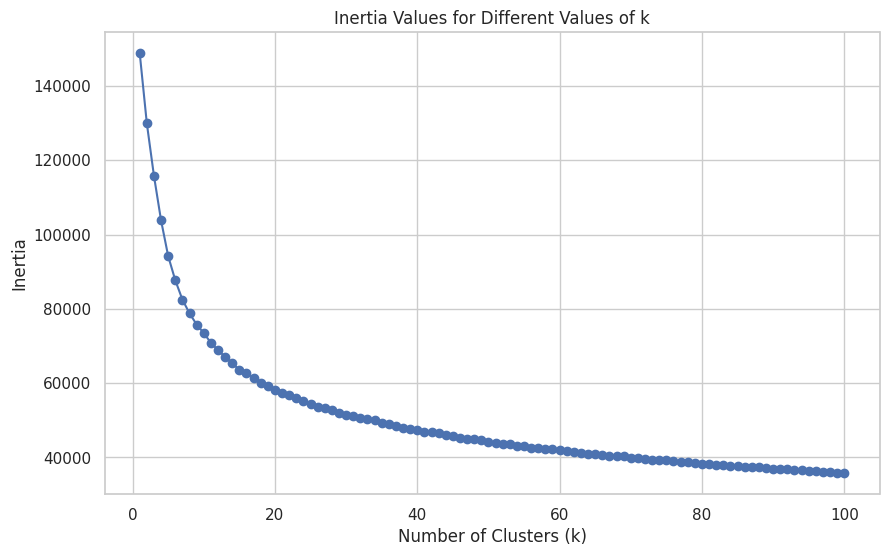

In [ ]:
import matplotlib.pyplot as plt
from tqdm import tqdm

# Initialize an empty list to store inertia values
inertia_values = []

# Test different values of k from 1 to 100
for k in tqdm(range(1, 101), desc="Testing k values", unit="k"):
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
    clusters = kmeans.fit_predict(crime_data_transformed)
    inertia_values.append(kmeans.inertia_)

# Plotting the inertia values
plt.figure(figsize=(10, 6))
plt.plot(range(1, 101), inertia_values, marker='o')
plt.title('Inertia Values for Different Values of k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()



In [ ]:
import seaborn as sns

# Apply k-means clustering with k = 20
kmeans = KMeans(n_clusters=20, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_data_transformed)

# Specify the center and zoom level for Charlottesville, VA
charlottesville_center = [38.0293, -78.4767]
zoom_level = 12

# Create a folium map centered around Charlottesville, VA
m = folium.Map(location=charlottesville_center, zoom_start=zoom_level, control_scale=False)

# Use seaborn to generate a palette of 65 distinct colors
cluster_colors = sns.color_palette("husl", 20).as_hex()

for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % len(cluster_colors)]
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

# Save the map as an HTML file (non-interactive)
m.save("cluster_map_20.html")

# Display the map using a web browser or another tool that supports HTML rendering
print("inertia value:", kmeans.inertia_)
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))



/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


inertia value: 1380.5481388417807
silhouette value:  0.2552863924229309


#Let's Try DBSCAN

In [ ]:
from sklearn.cluster import DBSCAN

# Apply db-scan with epsilon = .05 and min samples = 5
dbscan = DBSCAN(eps = .05, min_samples = 5)
clusters = dbscan.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

cluster_colors = ['blue', 'green', 'red', 'purple', 'orange', 'yellow', 'pink', 'cyan', 'brown']
for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % 9]  # Assign a color from the cluster_colors list
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

#display(m)
#print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


In [ ]:
# Apply db-scan with epsilon = .5 and min samples = 5
dbscan = DBSCAN(eps = .5, min_samples = 5)
clusters = dbscan.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

cluster_colors = ['blue', 'green', 'red', 'purple', 'orange', 'yellow', 'pink', 'cyan', 'brown']
for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % 9]  # Assign a color from the cluster_colors list
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

#m
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


silhouette value:  -0.2983886126352487


In [ ]:
# Apply db-scan with epsilon = .5 and min samples = 10
dbscan = DBSCAN(eps = .5, min_samples = 10)
clusters = dbscan.fit_predict(crime_data_transformed)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

cluster_colors = ['blue', 'green', 'red', 'purple', 'orange', 'yellow', 'pink', 'cyan', 'brown']
for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = cluster_colors[clusters[idx] % 9]  # Assign a color from the cluster_colors list
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

#m
print("silhouette value: ", silhouette_score(crime_data_transformed, clusters))


silhouette value:  -0.3351510388660295


Epsilon Progress: 100%|██████████| 19/19 [13:05<00:00, 41.36s/epsilon]


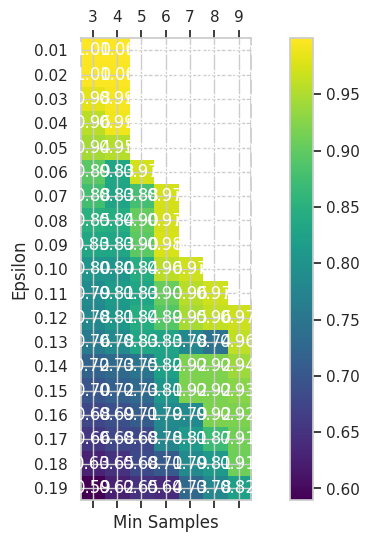

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

# Define a range of hyperparameter values to search
eps_values = np.arange(0.01, 0.2, 0.01)
min_samples_values = range(3, 10)

# Initialize lists to store results
silhouette_scores = []

# Grid search with progress bar
for eps in tqdm(eps_values, desc="Epsilon Progress", unit="epsilon"):
    for min_samples in tqdm(min_samples_values, desc="Min Samples Progress", unit="min_samples", leave=False):
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        clusters = dbscan.fit_predict(crime_data_transformed.toarray())  # Convert to dense array

        # Filter out noise points (-1 label)
        noise_mask = clusters != -1

        # Handle the case when all points are noise
        if np.all(~noise_mask):
            silhouette_scores.append(np.nan)
        else:
            unique_labels = np.unique(clusters[noise_mask])
            if len(unique_labels) > 1:
                silhouette_scores.append(silhouette_score(crime_data_transformed[noise_mask], clusters[noise_mask]))
            else:
                silhouette_scores.append(np.nan)  # Handle the case when all points are assigned the same label

# Reshape the results for plotting
silhouette_scores = np.array(silhouette_scores).reshape(len(eps_values), len(min_samples_values))

# Plotting the results
fig, ax = plt.subplots(figsize=(10, 6))
cax = ax.matshow(silhouette_scores, cmap="viridis")
fig.colorbar(cax)

# Set axis labels and ticks
ax.set_xticks(np.arange(len(min_samples_values)))
ax.set_yticks(np.arange(len(eps_values)))
ax.set_xticklabels(min_samples_values)
ax.set_yticklabels(["{:.2f}".format(eps) for eps in eps_values])

# Set axis labels
plt.xlabel('Min Samples')
plt.ylabel('Epsilon')

# Display the values on the heatmap
for i in range(len(eps_values)):
    for j in range(len(min_samples_values)):
        plt.text(j, i, '{:.2f}'.format(silhouette_scores[i, j]), ha='center', va='center', color='w')

plt.show()


# Clustering w/ Force Weight

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import folium
import os

# Assuming 'crime_data' is your DataFrame
# Selecting relevant features for clustering
features = ['Latitude', 'Longitude']

# Extracting the selected features
crime_locations = crime_data[features]

# Standardize the features (important for k-means)
scaler = StandardScaler()
crime_locations_scaled = scaler.fit_transform(crime_locations)

# Coordinates for Charlottesville, VA
charlottesville_coords = [38.0293, -78.4767]
zoom_level = 12

# Test different values of k
k_values = [5, 10, 15, 20, 30, 40, 50]

# Create a directory to save HTML files
output_directory = 'cluster_maps'
os.makedirs(output_directory, exist_ok=True)

cluster_colors = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
    '#FF5733', '#33FF57', '#5733FF', '#FF33E9', '#FFE933',
    '#8B4513', '#00FFFF', '#8A2BE2', '#00FF00', '#FFD700',
    '#00BFFF', '#7B68EE', '#00FA9A', '#FF1493', '#32CD32',
    '#FF4500', '#00CED1', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#FF69B4'
]


for k in k_values:
    # Apply k-means clustering
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
    clusters = kmeans.fit_predict(crime_locations_scaled)

    # Adding cluster information to the original DataFrame
    crime_data[f'Cluster_{k}'] = clusters

    # Print inertia value
    inertia_value = kmeans.inertia_
    print(f"Inertia value for k={k}: {inertia_value}")

    # Visualizing the clusters on a map using Folium
    m = folium.Map(location=charlottesville_coords, zoom_start=13)

    # Add markers to the map based on clusters
    for idx, row in crime_data.iterrows():
        color = cluster_colors[row[f'Cluster_{k}']]
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

    # Add title to the map
    title_html = f'<h3 align="center">Clusters for k={k}</h3>'
    m.get_root().html.add_child(folium.Element(title_html))

    # Save the map as an HTML file
    output_file = os.path.join(output_directory, f'kcluster_map_k_{k}.html')
    m.save(output_file)

    print(f"Map for k={k} saved as {output_file}")

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=5: 9794.120017655212
Map for k=5 saved as cluster_maps/kcluster_map_k_5.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=10: 4484.318081779591
Map for k=10 saved as cluster_maps/kcluster_map_k_10.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=15: 2708.7811947308473
Map for k=15 saved as cluster_maps/kcluster_map_k_15.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=20: 2087.9341342259486
Map for k=20 saved as cluster_maps/kcluster_map_k_20.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=30: 1232.181985282578
Map for k=30 saved as cluster_maps/kcluster_map_k_30.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=40: 787.2744054119371
Map for k=40 saved as cluster_maps/kcluster_map_k_40.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Inertia value for k=50: 607.1449443712636
Map for k=50 saved as cluster_maps/kcluster_map_k_50.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

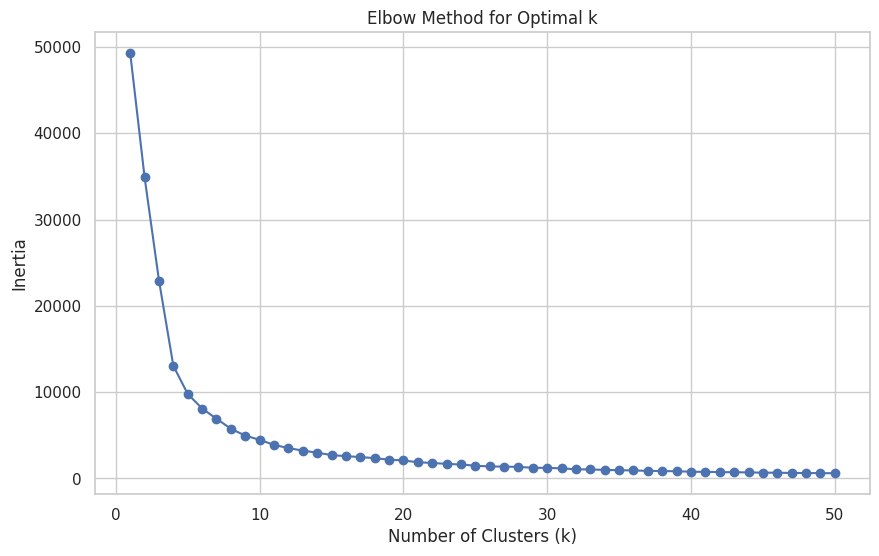

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Assuming 'crime_data' is your DataFrame
# Selecting relevant features for clustering
features = ['Latitude', 'Longitude']

# Extracting the selected features
crime_locations = crime_data[features]

# Standardize the features (important for k-means)
scaler = StandardScaler()
crime_locations_scaled = scaler.fit_transform(crime_locations)

# Test different values of k
k_values = range(1, 51)
inertia_values = []

for k in k_values:
    # Apply k-means clustering
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
    kmeans.fit(crime_locations_scaled)

    # Append the inertia to the list
    inertia_values.append(kmeans.inertia_)

# Plotting the inertia values
plt.figure(figsize=(10, 6))
plt.plot(k_values, inertia_values, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()


In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import folium
import os

# Assuming 'crime_data' is your DataFrame
# Selecting relevant features for clustering
features = ['Latitude', 'Longitude', 'HourReported']

# Extracting the selected features
crime_locations = crime_data[features]

# Standardize the features (important for k-means)
scaler = StandardScaler()
crime_locations_scaled = scaler.fit_transform(crime_locations[['Latitude', 'Longitude']])

# Coordinates for Charlottesville, VA
charlottesville_coords = [38.0293, -78.4767]

# Test different values of k
k_values = [50]

# Create a directory to save HTML files
output_directory = 'cluster_maps'
os.makedirs(output_directory, exist_ok=True)

cluster_colors = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
    '#FF5733', '#33FF57', '#5733FF', '#FF33E9', '#FFE933',
    '#8B4513', '#00FFFF', '#8A2BE2', '#00FF00', '#FFD700',
    '#00BFFF', '#7B68EE', '#00FA9A', '#FF1493', '#32CD32',
    '#FF4500', '#00CED1', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#FF69B4'
]

for k in k_values:
    for hour in range(0, 2400, 100):
        # Filter data for the current hour
        hour_data = crime_locations[(crime_locations['HourReported'] >= hour) & (crime_locations['HourReported'] < hour + 100)]

        if not hour_data.empty:
            # Apply k-means clustering
            kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
            clusters = kmeans.fit_predict(hour_data[['Latitude', 'Longitude']])

            # Adding cluster information to the original DataFrame
            hour_data[f'Cluster_{k}'] = clusters

            # Visualizing the clusters on a map using Folium
            m = folium.Map(location=charlottesville_coords, zoom_start=13)

            # Add markers to the map based on clusters
            for idx, row in hour_data.iterrows():
                color = cluster_colors[int(row[f'Cluster_{k}'])]
                folium.CircleMarker(
                    location=[row['Latitude'], row['Longitude']],
                    radius=3,
                    color=color,
                    fill=True
                ).add_to(m)

            # Add title to the map
            title_html = f'<h3 align="center">Clusters for k={k} - Hour Range {hour} to {hour + 100}</h3>'
            m.get_root().html.add_child(folium.Element(title_html))

            # Save the map as an HTML file
            output_file = os.path.join(output_directory, f'kcluster_map_k_{k}_hour_{hour}_{hour + 100}.html')
            m.save(output_file)

            print(f"Map for k={k} and hour range {hour} to {hour + 100} saved as {output_file}")
        else:
            print(f"No data for hour range {hour} to {hour + 100}")



/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 0 to 100 saved as cluster_maps/kcluster_map_k_50_hour_0_100.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 100 to 200 saved as cluster_maps/kcluster_map_k_50_hour_100_200.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 200 to 300 saved as cluster_maps/kcluster_map_k_50_hour_200_300.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 300 to 400 saved as cluster_maps/kcluster_map_k_50_hour_300_400.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 400 to 500 saved as cluster_maps/kcluster_map_k_50_hour_400_500.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 500 to 600 saved as cluster_maps/kcluster_map_k_50_hour_500_600.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 600 to 700 saved as cluster_maps/kcluster_map_k_50_hour_600_700.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 700 to 800 saved as cluster_maps/kcluster_map_k_50_hour_700_800.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 800 to 900 saved as cluster_maps/kcluster_map_k_50_hour_800_900.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 900 to 1000 saved as cluster_maps/kcluster_map_k_50_hour_900_1000.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1000 to 1100 saved as cluster_maps/kcluster_map_k_50_hour_1000_1100.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1100 to 1200 saved as cluster_maps/kcluster_map_k_50_hour_1100_1200.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1200 to 1300 saved as cluster_maps/kcluster_map_k_50_hour_1200_1300.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1300 to 1400 saved as cluster_maps/kcluster_map_k_50_hour_1300_1400.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1400 to 1500 saved as cluster_maps/kcluster_map_k_50_hour_1400_1500.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1500 to 1600 saved as cluster_maps/kcluster_map_k_50_hour_1500_1600.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1600 to 1700 saved as cluster_maps/kcluster_map_k_50_hour_1600_1700.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1700 to 1800 saved as cluster_maps/kcluster_map_k_50_hour_1700_1800.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1800 to 1900 saved as cluster_maps/kcluster_map_k_50_hour_1800_1900.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 1900 to 2000 saved as cluster_maps/kcluster_map_k_50_hour_1900_2000.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 2000 to 2100 saved as cluster_maps/kcluster_map_k_50_hour_2000_2100.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 2100 to 2200 saved as cluster_maps/kcluster_map_k_50_hour_2100_2200.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 2200 to 2300 saved as cluster_maps/kcluster_map_k_50_hour_2200_2300.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-13-02ac37704e42>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for k=50 and hour range 2300 to 2400 saved as cluster_maps/kcluster_map_k_50_hour_2300_2400.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

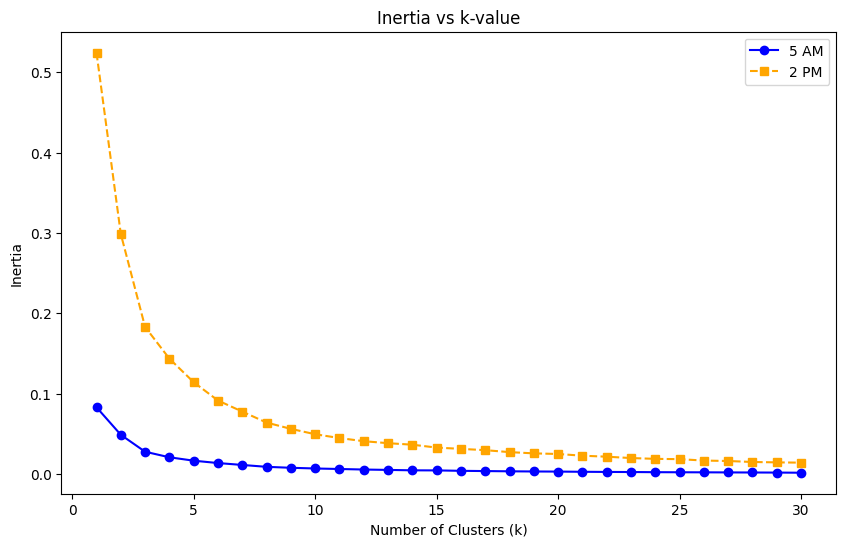

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'crime_data' is your DataFrame

# Selecting relevant features for clustering
features = ['Latitude', 'Longitude', 'HourReported']

# Extracting the selected features
crime_locations = crime_data[features]

# Standardize the features (important for k-means)
scaler = StandardScaler()
crime_locations_scaled = scaler.fit_transform(crime_locations[['Latitude', 'Longitude']])

# Coordinates for Charlottesville, VA
charlottesville_coords = [38.0293, -78.4767]

# Define hours to analyze
hours_to_analyze = [500, 1400]

# Range of k-values to test
k_values = range(1, 31)

# Create lists to store inertia values for each hour
inertia_values_500 = []
inertia_values_1400 = []

# Iterate over each hour
for hour in hours_to_analyze:
    # Filter data for the current hour
    hour_data = crime_locations[(crime_locations['HourReported'] >= hour) & (crime_locations['HourReported'] < hour + 100)]

    # Apply k-means clustering and calculate inertia values
    inertia_values = []
    for k in k_values:
        kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
        kmeans.fit(hour_data[['Latitude', 'Longitude']])
        inertia_values.append(kmeans.inertia_)

    # Store inertia values based on the current hour
    if hour == 500:
        inertia_values_500 = inertia_values
    elif hour == 1400:
        inertia_values_1400 = inertia_values

# Plotting the inertia vs k-value graphs on the same plot with legend
plt.figure(figsize=(10, 6))

plt.plot(k_values, inertia_values_500, marker='o', label='5 AM', linestyle='-', color='blue')
plt.plot(k_values, inertia_values_1400, marker='s', label='2 PM', linestyle='--', color='orange')

plt.title('Inertia vs k-value')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.legend()
plt.show()



In [ ]:
import folium

# Assuming 'crime_data' is your DataFrame
features = ['Latitude', 'Longitude', 'HourReported']

# Extracting the selected features
crime_locations = crime_data[features]

# Standardize the features (important for k-means)
scaler = StandardScaler()
crime_locations_scaled = scaler.fit_transform(crime_locations[['Latitude', 'Longitude']])

# Coordinates for Charlottesville, VA
charlottesville_coords = [38.0293, -78.4767]

# Create a directory to save HTML files
output_directory = 'cluster_maps'
os.makedirs(output_directory, exist_ok=True)

# Define k-values and hours
k_values = {'Hour_500': 4, 'Hour_1400': 10}
hours = {'Hour_500': 500, 'Hour_1400': 1400}

cluster_colors = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
    '#FF5733', '#33FF57', '#5733FF', '#FF33E9', '#FFE933',
    '#8B4513', '#00FFFF', '#8A2BE2', '#00FF00', '#FFD700',
    '#00BFFF', '#7B68EE', '#00FA9A', '#FF1493', '#32CD32',
    '#FF4500', '#00CED1', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#FF69B4'
]

# Create cluster maps for each hour and k-value
for key, k in k_values.items():
    # Filter data for the current hour
    hour_data = crime_locations[(crime_locations['HourReported'] >= hours[key]) & (crime_locations['HourReported'] < hours[key] + 100)]

    if not hour_data.empty:
        # Apply k-means clustering
        kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
        clusters = kmeans.fit_predict(hour_data[['Latitude', 'Longitude']])

        # Adding cluster information to the original DataFrame
        hour_data[f'Cluster_{k}'] = clusters

        # Visualizing the clusters on a map using Folium
        m = folium.Map(location=charlottesville_coords, zoom_start=13)

        # Add markers to the map based on clusters
        for idx, row in hour_data.iterrows():
            color = cluster_colors[int(row[f'Cluster_{k}'])]
            folium.CircleMarker(
                location=[row['Latitude'], row['Longitude']],
                radius=3,
                color=color,
                fill=True
            ).add_to(m)

        # Add title to the map
        title_html = f'<h3 align="center">Clusters for {key} - k={k}</h3>'
        m.get_root().html.add_child(folium.Element(title_html))

        # Save the map as an HTML file
        output_file = os.path.join(output_directory, f'kcluster_map_{key}_k_{k}.html')
        m.save(output_file)

        print(f"Map for {key} and k={k} saved as {output_file}")
    else:
        print(f"No data for {key}")


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-24-a4db0cd60387>:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for Hour_500 and k=4 saved as cluster_maps/kcluster_map_Hour_500_k_4.html


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-24-a4db0cd60387>:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hour_data[f'Cluster_{k}'] = clusters


Map for Hour_1400 and k=10 saved as cluster_maps/kcluster_map_Hour_1400_k_10.html


In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import folium
import os

# Assuming 'crime_data' is your DataFrame
# Selecting relevant features for clustering
features = ['Latitude', 'Longitude']

# Extracting the selected features
crime_locations = crime_data[features]

# Standardize the features (important for k-means)
scaler = StandardScaler()
crime_locations_scaled = scaler.fit_transform(crime_locations)

# Apply k-means clustering with k = 5
kmeans = KMeans(n_clusters=9, init='k-means++', random_state=42)
clusters = kmeans.fit_predict(crime_locations_scaled)

m = folium.Map(location=[(37.8 + 38.2) / 2, (-78.75 - 78.25) / 2], zoom_start=12)

for idx, row in crime_data.iterrows():
    if -78.75 <= row['Longitude'] <= -78.25 and 37.8 <= row['Latitude'] <= 38.2:
        color = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
    '#FF5733', '#33FF57', '#5733FF', '#FF33E9', '#FFE933',
    '#8B4513', '#00FFFF', '#8A2BE2', '#00FF00', '#FFD700',
    '#00BFFF', '#7B68EE', '#00FA9A', '#FF1493', '#32CD32',
    '#FF4500', '#00CED1', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#1E90FF',
    '#7CFC00', '#FFD700', '#FF6347', '#00BFFF', '#8A2BE2',
    '#32CD32', '#FF4500', '#8B008B', '#8FBC8F', '#FF69B4'
        ][clusters[idx]]
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=color,
            fill=True
        ).add_to(m)

display(m)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
